In [2]:
import xarray as xr
import numpy as np
from datetime import datetime, timedelta
from cartopy.feature.nightshade import Nightshade
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import os, glob, sys
import tqdm.auto as tqdm
import pandas as pd

/glade/work/abukowski/conda-envs/SAMI3-GITM/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [545]:
import argparse
import glob
import os
from datetime import timedelta

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
import xarray as xr

import utility_programs.filters as filters
from utility_programs.plotting_routines import panel_plot
from utility_programs.read_routines.GITM import auto_read as auto_read_gitm
from utility_programs.read_routines.GITM import gitm_times_from_filelist
from utility_programs.read_routines.SAMI import auto_read as auto_read_sami
from utility_programs import plotting_routines
from utility_programs.utils import ut_to_lt
import importlib

In [4]:
def panel_of_dials(da, hemi_titles, times,
                   time_titles=None, 
                   title=None,
                  **plotargs):
    
    if time_titles is not None:
        time_titles = np.array(time_titles)
    hemi_titles = np.array(hemi_titles)
    times = np.array(times)

    if hemi_titles.shape != times.shape:
        raise ValueError('Title specs must match!')
        

    fig = plt.figure(figsize=[4*hemi_titles.shape[1],4*hemi_titles.shape[0]])

    axs = []

    for i, ax in enumerate(np.ndindex(hemi_titles.shape[0], hemi_titles.shape[1])):
        
        time_here = pd.Timestamp(str(times[ax])).to_pydatetime()
        
        ## Find central longitude (midnight Local time)
        lons = np.arange(0,360)
        lts = ut_to_lt([time_here], lons)
        central_lon = lons[np.argmin(np.abs(24-lts))]

        if hemi_titles[ax] == 'North':
            axs.append(fig.add_subplot(hemi_titles.shape[0], hemi_titles.shape[1], i+1, projection=ccrs.Orthographic(central_lon, 90)))

        elif hemi_titles[ax] == 'South':
            axs.append(fig.add_subplot(hemi_titles.shape[0], hemi_titles.shape[1], i+1, projection=ccrs.Orthographic(central_lon-180, -90)))


        da.sel(time=times[ax],method='nearest').plot(x='lon', y='lat',ax=axs[-1],
                                                           transform=ccrs.PlateCarree(),
                                                           cbar_kwargs={'label': ""},
                                                    **plotargs)

        if time_titles is None:
            axs[-1].set_title('%s (%s UT)' %(hemi_titles[ax], str(time_here.time())[:5]))
        else:
            axs[-1].set_title('%s, %s Storm (%s UT)' %(hemi_titles[ax], time_titles[ax], str(time_here.time())[:5]))
            

        axs[-1].coastlines(zorder=3, color='black', alpha=0.6)
        axs[-1].gridlines(color='black', linestyle='--', alpha = 0.4)
        axs[-1].add_feature(Nightshade(time_here), alpha = 0.3)

    if title is not None:
        size = plt.Text.get_size(fig.suptitle('asd'))
        fig.suptitle(title, fontsize=size+4)

    fig.tight_layout()

    return fig

In [19]:
def loop_panels(da,
                ncols,
                start_time,
                time_delta='1 hour',
                sel_criteria=None,
                suptitle=None,
                title=None,
                col_names=None,
                save=None,
                ret=False,
                **plotargs):

    hemititles = [['North', 'South'] for i in range(ncols)]
    hemititles = np.array(hemititles).T
    times = []
    for i in range(ncols):
        times.append(pd.Timestamp(start_time) + pd.Timedelta(time_delta)*i)

    times = np.array([times, times])
    timetitles = None
    if col_names is not None:
        timetitles = np.array([col_names, col_names])

    if sel_criteria is None:
        fig = panel_of_dials(da,
                       hemi_titles=hemititles,
                       times=times,
                       time_titles=timetitles,
                       title=title,
                       **plotargs)
        if save is not None:
            plt.savefig(save)
        elif ret:
            return fig
        else:
            plt.show()
    else:
        if type(sel_criteria) == dict:
            panel_of_dials(da.sel(sel_criteria, method='nearest'), hemi_titles=hemititles,
                           times=times,
                           time_titles=timetitles,
                           title=title + ' at %s = %i' % (list(sel_criteria.keys())[0],
                                                          list(sel_criteria.values())[0])
                           ** plotargs)
            if save is not None:
                plt.savefig(save)
            else:
                plt.show()
        else:
            for entry in sel_criteria:
                panel_of_dials(da.sel(entry, method='nearest'), hemi_titles=hemititles,
                               times=times,
                               time_titles=timetitles,
                               title=title + ' at %s = %i' % (list(entry.keys())[0],
                                                              int(list(entry.values())[0])),
                               ** plotargs)
                if save is not None:
                    plt.savefig(save)
                else:
                    plt.show()

# Full vs Half Amplitude Storm (in May)

In [207]:
JH_may = xr.Dataset()

ds_half_may = xr.open_mfdataset(np.sort(glob.glob('../scratch/simstorm-20110521/postprocessed/Half/*GITM*'))[::12])
ds_full_may = xr.open_mfdataset(np.sort(glob.glob('../scratch/simstorm-20110521/postprocessed/Full/*GITM*'))[::12])

JH_may['fullstorm'] = ds_full_may.AltIntJouleHeating_W_m2
JH_may['halfstorm'] = ds_half_may.AltIntJouleHeating_W_m2.reindex_like(ds_full_may, method='nearest')

## Altitude Integrated Joule Heating

### Comparing before/after storm onset

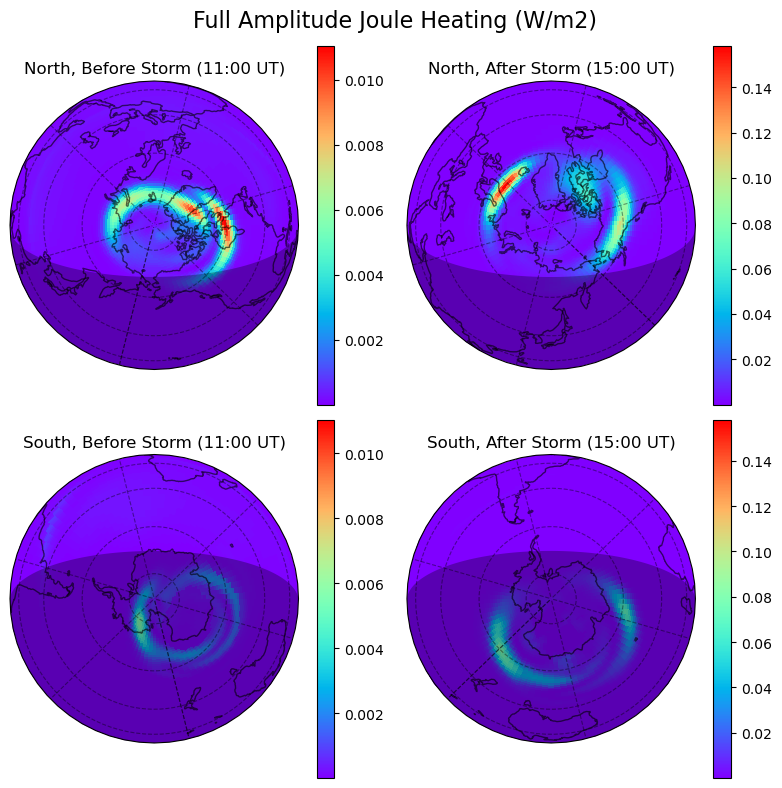

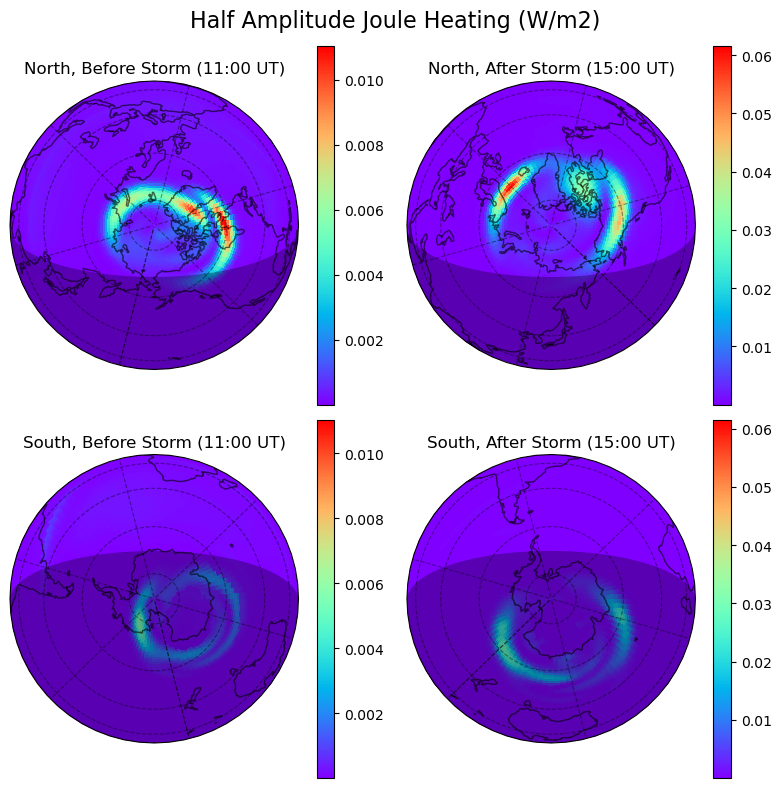

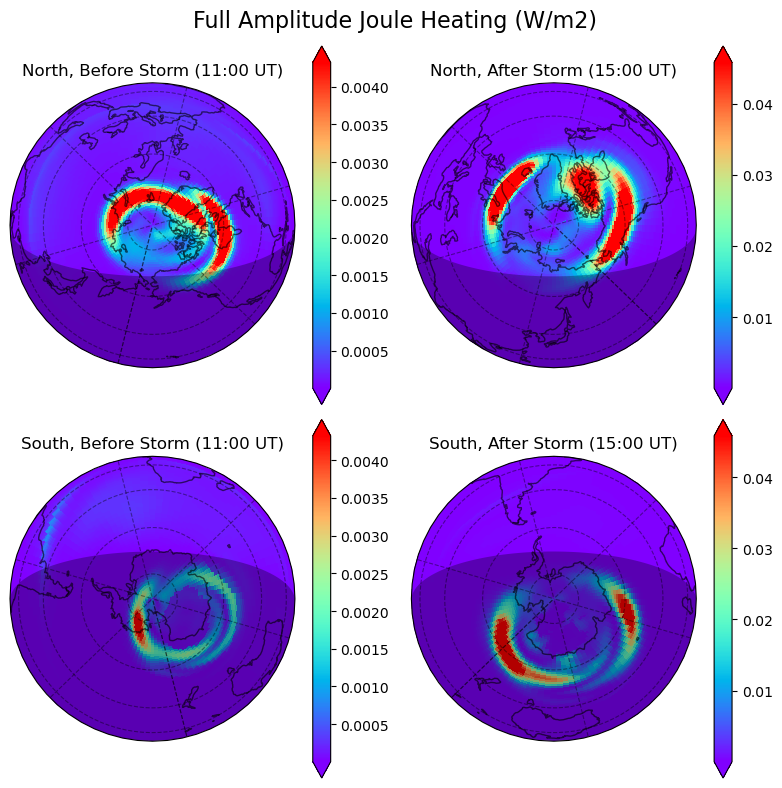

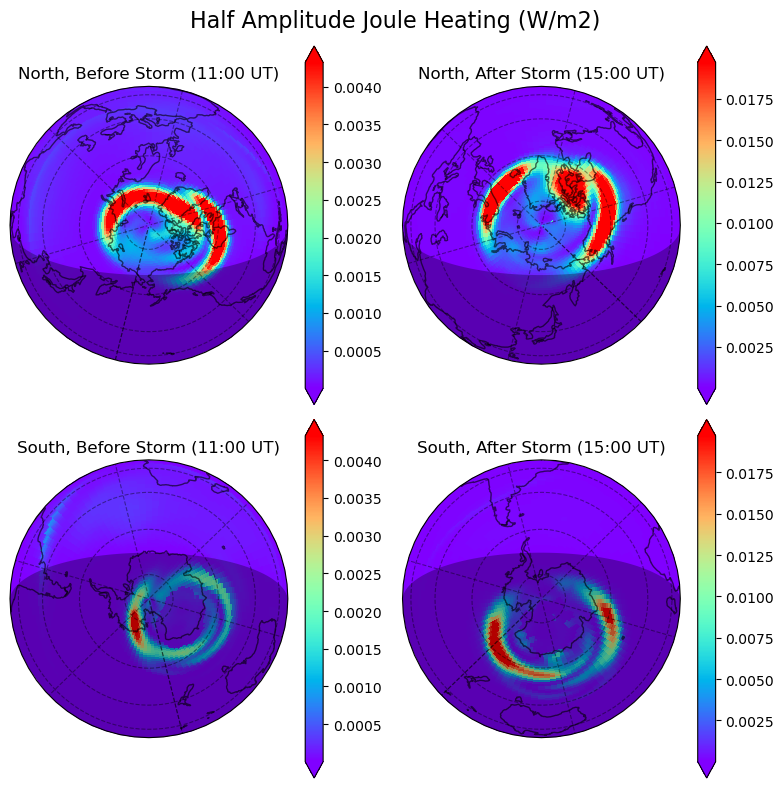

In [261]:
loop_panels(JH_may.fullstorm, ncols=2, title='Full Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='4 hours', 
            col_names = ['Before', 'After'], cmap='rainbow')

loop_panels(JH_may.halfstorm, ncols=2, title='Half Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='4 hours', 
            col_names = ['Before', 'After'], cmap='rainbow')

loop_panels(JH_may.fullstorm, ncols=2, title='Full Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='4 hours', 
            col_names = ['Before', 'After'], cmap='rainbow', robust=True)

loop_panels(JH_may.halfstorm, ncols=2, title='Half Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='4 hours', 
            col_names = ['Before', 'After'], cmap='rainbow', robust=True)

### Altitude Integrated Joule Heating throughout run

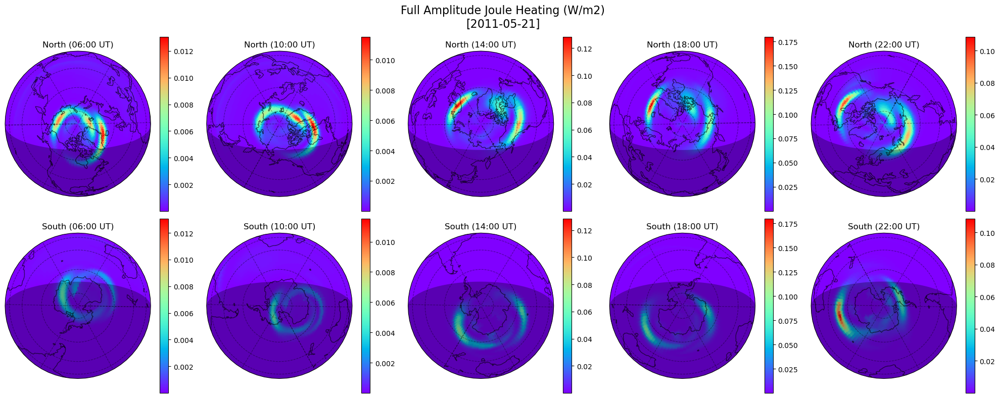

In [248]:
loop_panels(JH_may.fullstorm, ncols=5, title='Full Amplitude Joule Heating (W/m2)\n[2011-05-21]',
            start_time= pd.Timestamp('2011-05-21 6:00'), time_delta='4 hours', 
            cmap='rainbow')

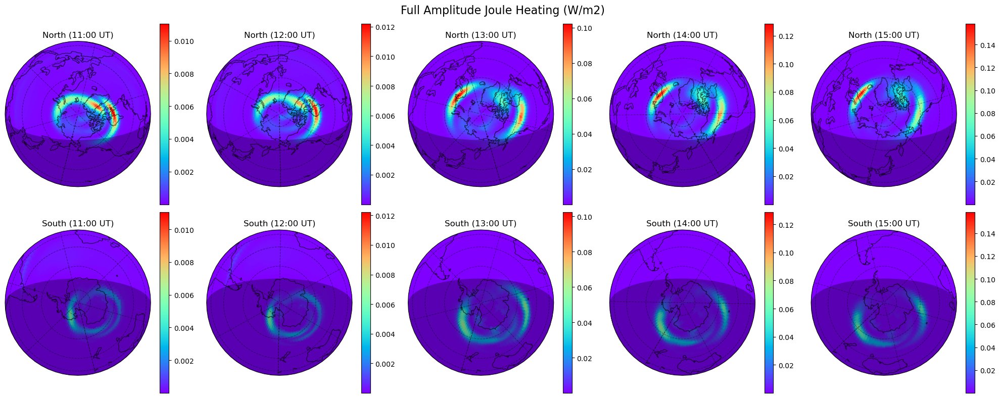

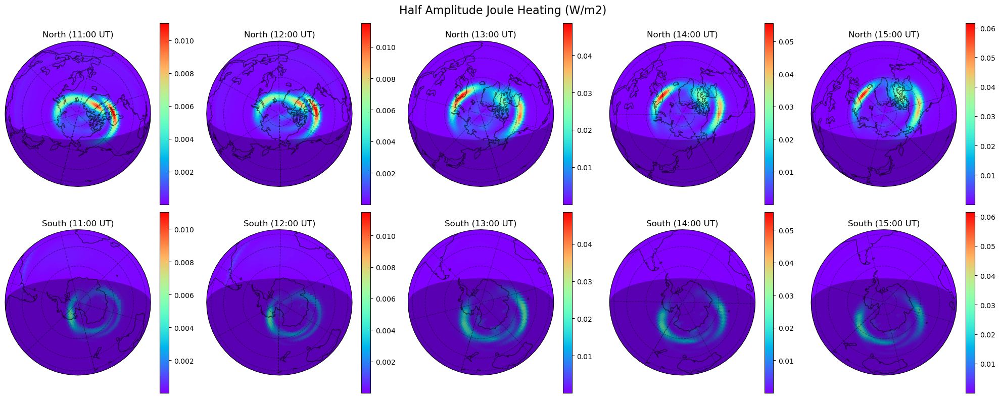

In [245]:
loop_panels(JH_may.fullstorm, ncols=5, title='Full Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='1 hours', 
            cmap='rainbow')

loop_panels(JH_may.halfstorm, ncols=5, title='Half Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='1 hours', 
            cmap='rainbow')

In [ ]:
loop_panels(JH_may.fullstorm - JH_may.halfstorm, ncols=5, title='Difference in Joule Heating (W/m2) (Full - Half)',
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='1 hours', 
            cmap='rainbow')

### Rate of change of Joule Heating

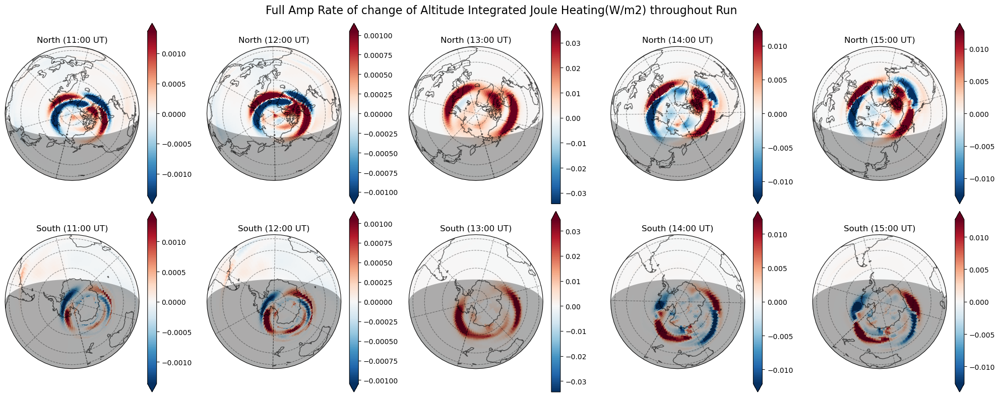

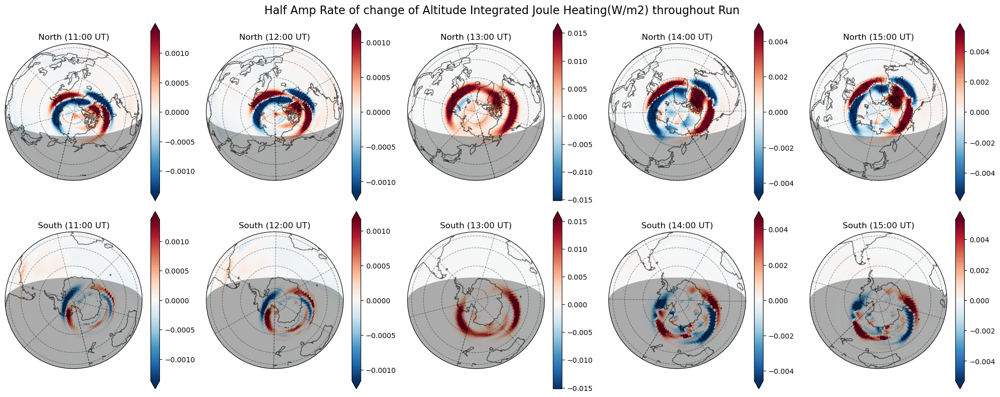

In [253]:

title = 'Rate of change of Altitude Integrated Joule Heating(W/m2) throughout Run'

loop_panels(JH_may.fullstorm.diff('time'), ncols=5, title='Full Amp ' + title,
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='1 hours', 
            robust=True)

loop_panels(JH_may.halfstorm.diff('time'), ncols=5, title='Half Amp ' + title,
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='1 hours', 
            robust=True)

## Temperature

In [265]:
temp_may = xr.Dataset()


temp_may['fullstorm'] = ds_full_may.Temperature
temp_may['halfstorm'] = ds_half_may.Temperature.reindex_like(ds_full_may, method='nearest')

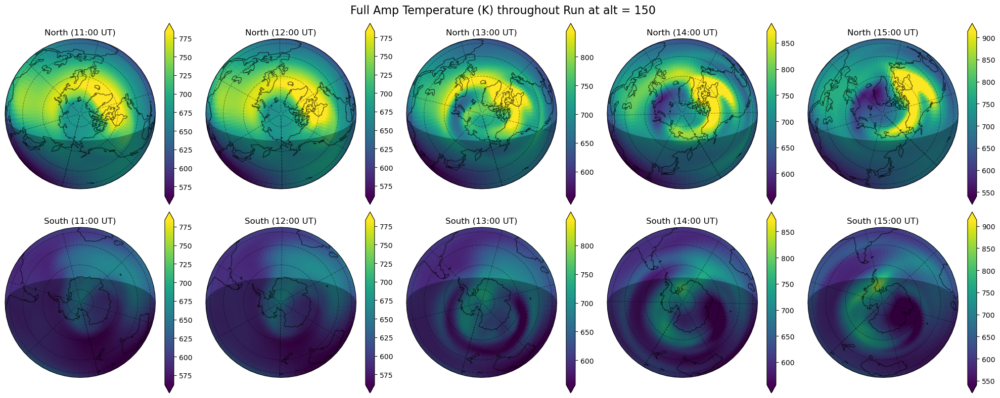

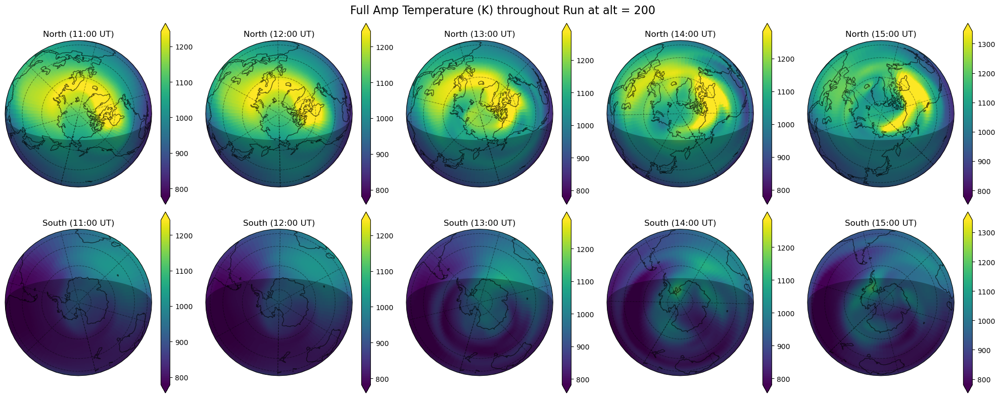

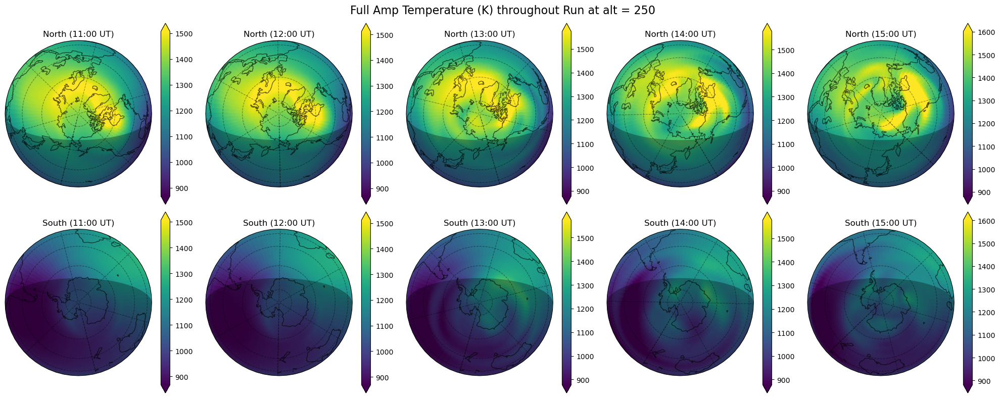

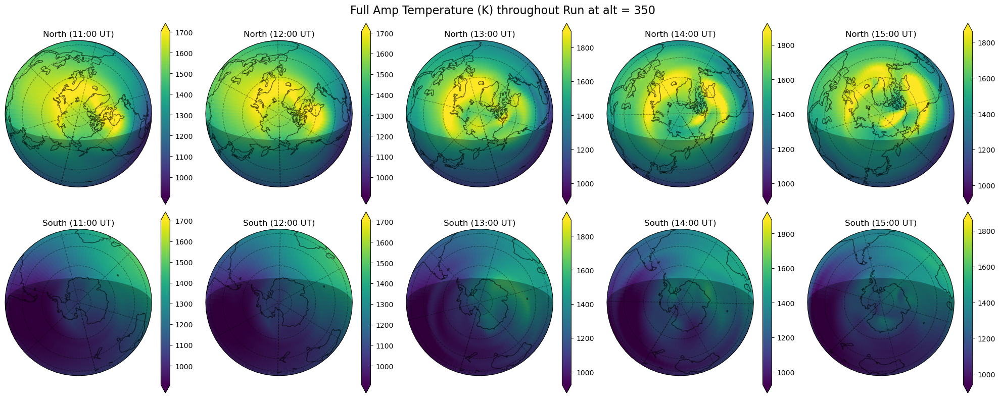

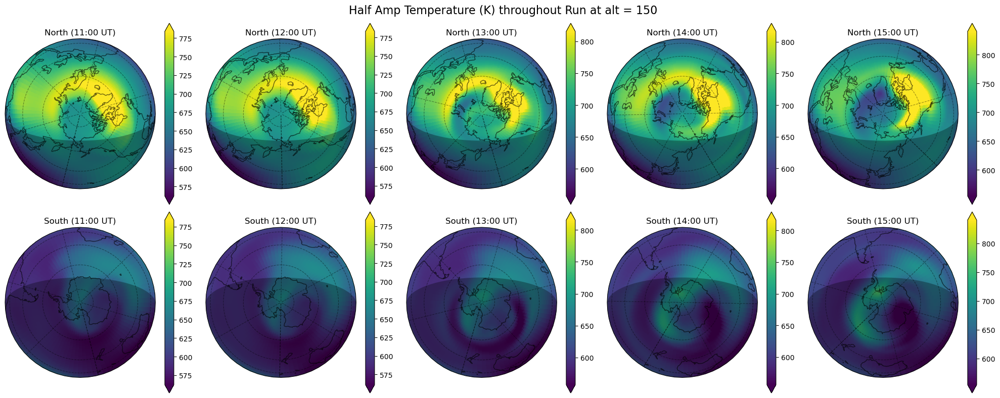

...

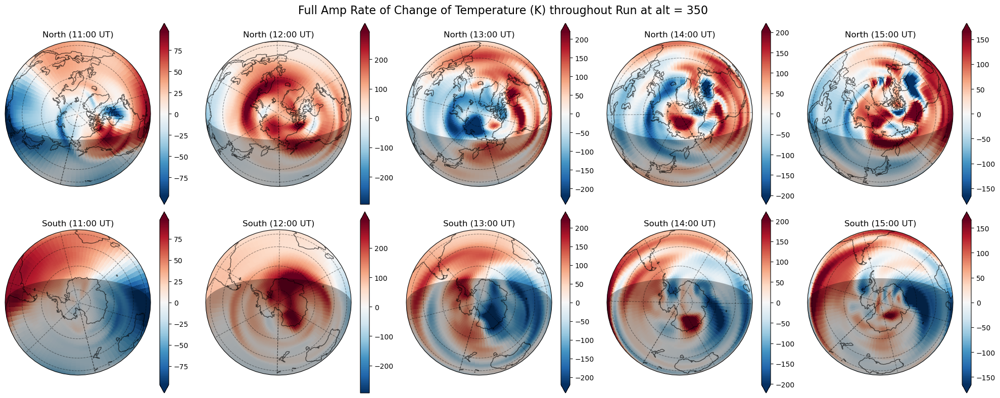

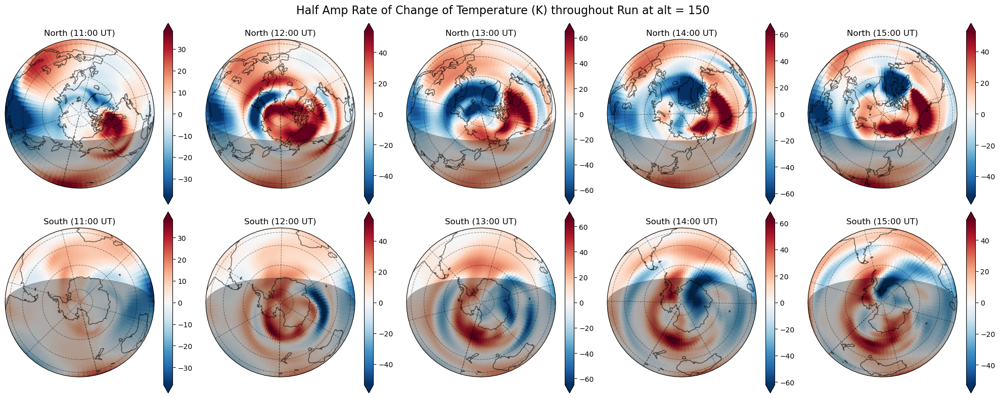

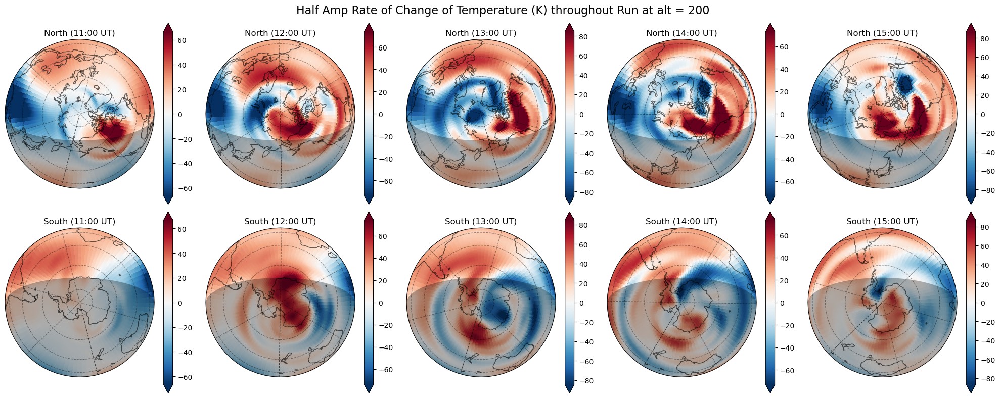

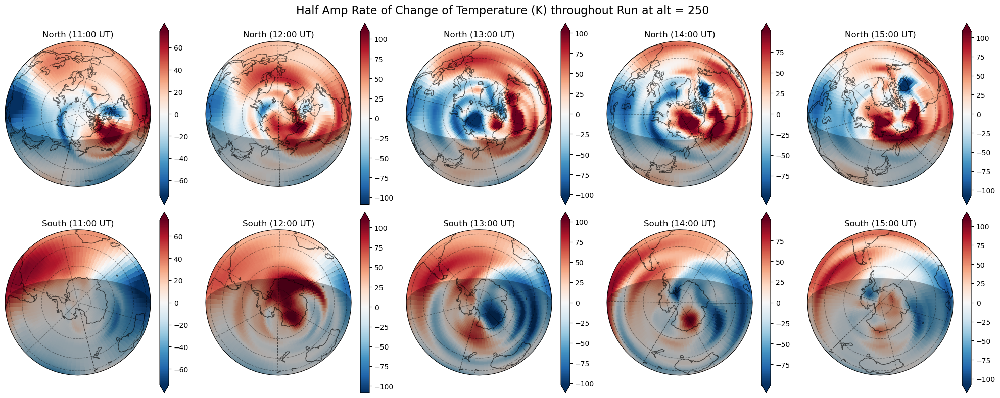

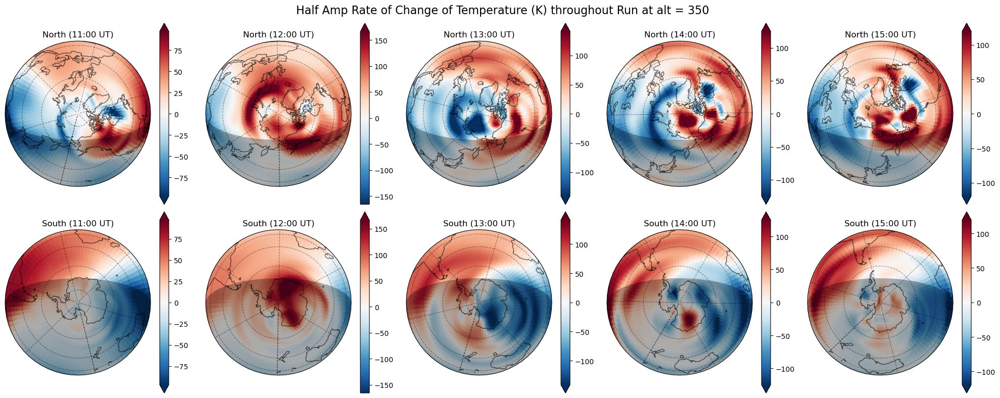

In [272]:
title = 'Temperature (K) throughout Run'

plots = [{'alt':150},
         {'alt':200},
         {'alt':250},
         {'alt':350}]
         

loop_panels(temp_may.fullstorm, ncols=5, title='Full Amp ' + title,
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

loop_panels(temp_may.halfstorm, ncols=5, title='Half Amp ' + title,
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

loop_panels(temp_may.fullstorm.diff('time', label ='lower'), ncols=5, title='Full Amp Rate of Change of ' + title,
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

loop_panels(temp_may.halfstorm.diff('time', label='lower'), ncols=5, title='Half Amp Rate of Change of ' + title,
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

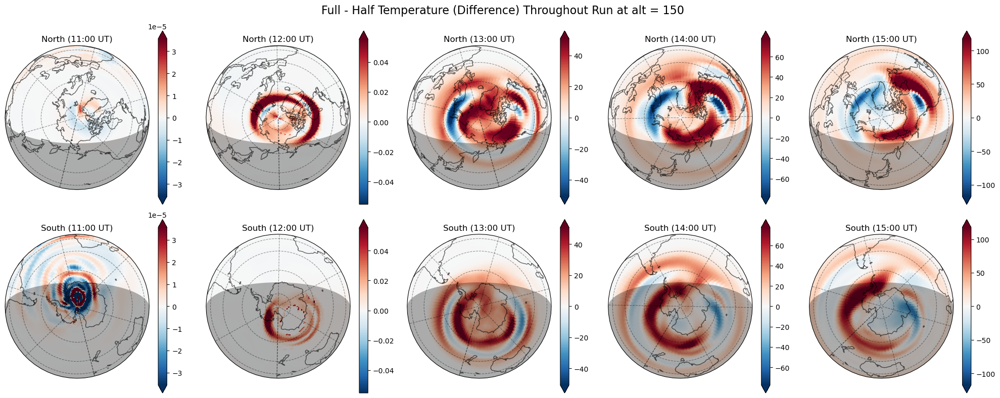

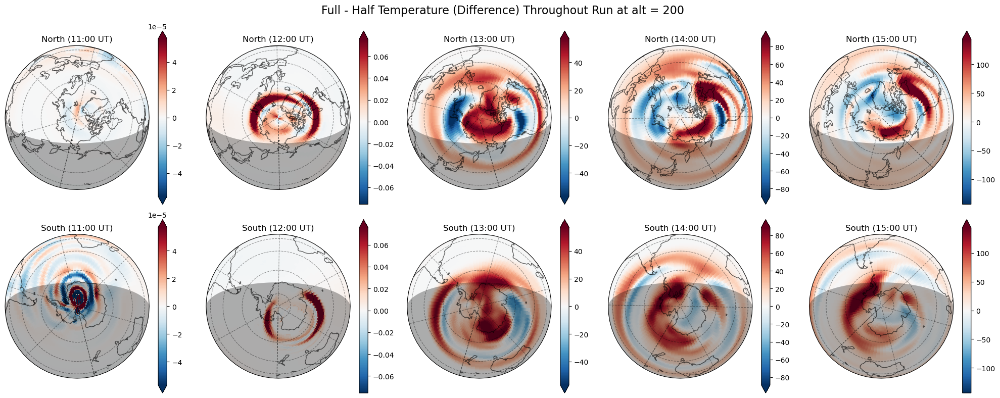

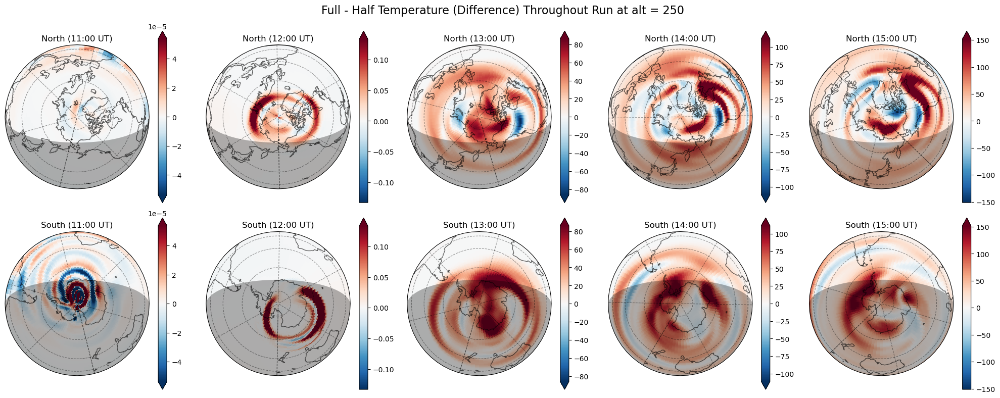

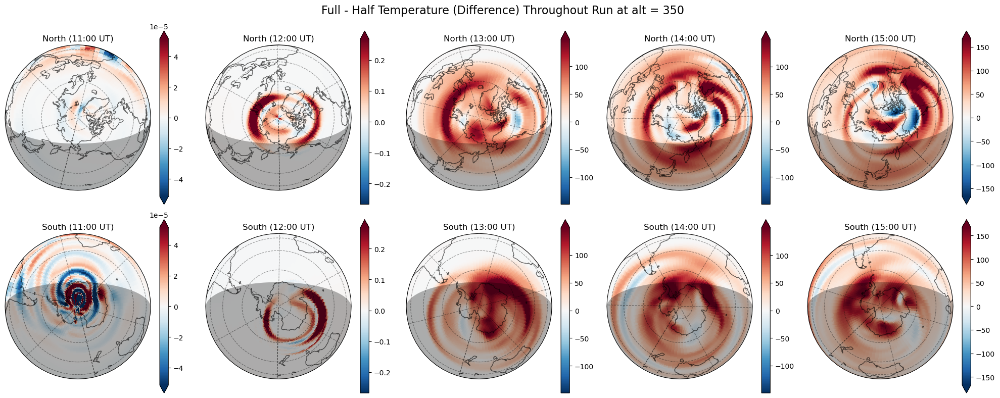

In [274]:

plots = [{'alt':150},
         {'alt':200},
         {'alt':250},
         {'alt':350}]
         

loop_panels(temp_may.fullstorm-temp_may.halfstorm, ncols=5, title='Full - Half Temperature (Difference) Throughout Run',
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

## Full vs Half Amplitude Storm (in Nov)

In [ ]:
JH_nov = xr.Dataset()

nov_half= xr.open_mfdataset(np.sort(glob.glob('../scratch/simstorm-20111121/postprocessed/Half/*GITM*'))[::12])
nov_full = xr.open_mfdataset(np.sort(glob.glob('../scratch/simstorm-20111121/postprocessed/Full/*GITM*'))[::12])

JH_nov['fullstorm'] = nov_full.AltIntJouleHeating_W_m2
JH_nov['halfstorm'] = nov_half.AltIntJouleHeating_W_m2.reindex_like(nov_full, method='nearest')

In [ ]:
loop_panels(JH_nov.fullstorm, ncols=2, title='Full Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
            col_names = ['Before', 'After'], cmap='rainbow')

loop_panels(JH_nov.halfstorm, ncols=2, title='Half Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
            col_names = ['Before', 'After'], cmap='rainbow')

loop_panels(JH_nov.fullstorm, ncols=2, title='Full Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
            col_names = ['Before', 'After'], cmap='rainbow', robust=True)

loop_panels(JH_nov.halfstorm, ncols=2, title='Half Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
            col_names = ['Before', 'After'], cmap='rainbow', robust=True)

### Altitude Integrated Joule Heating throughout run

In [ ]:
loop_panels(JH_nov.fullstorm, ncols=5, title='Full Amplitude Joule Heating (W/m2)\n[2011-11-21]',
            start_time= pd.Timestamp('2011-11-21 6:00'), time_delta='4 hours', 
            cmap='rainbow')

In [ ]:
loop_panels(JH_nov.fullstorm, ncols=5, title='Full Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='1 hours', 
            cmap='rainbow')

loop_panels(JH_nov.halfstorm, ncols=5, title='Half Amplitude Joule Heating (W/m2)',
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='1 hours', 
            cmap='rainbow')

### Rate of change of Joule Heating

In [ ]:

title = 'Rate of change of Altitude Integrated Joule Heating(W/m2) throughout Run'

loop_panels(JH_nov.fullstorm.diff('time'), ncols=5, title='Full Amp ' + title,
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='1 hours', 
            robust=True)

loop_panels(JH_nov.halfstorm.diff('time'), ncols=5, title='Half Amp ' + title,
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='1 hours', 
            robust=True)

## Temperature

In [ ]:
temp_nov = xr.Dataset()


temp_nov['fullstorm'] = ds_full_nov.Temperature
temp_nov['halfstorm'] = ds_half_nov.Temperature.reindex_like(ds_full_nov, method='nearest')

In [ ]:
title = 'Temperature (K) throughout Run'

plots = [{'alt':150},
         {'alt':200},
         {'alt':250},
         {'alt':350}]
         

loop_panels(temp_nov.fullstorm, ncols=5, title='Full Amp ' + title,
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

loop_panels(temp_nov.halfstorm, ncols=5, title='Half Amp ' + title,
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

loop_panels(temp_nov.fullstorm.diff('time', label ='lower'), ncols=5, title='Full Amp Rate of Change of ' + title,
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

loop_panels(temp_nov.halfstorm.diff('time', label='lower'), ncols=5, title='Half Amp Rate of Change of ' + title,
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

In [ ]:
loop_panelsts = [{'alt':150},
         {'alt':200},
         {'alt':250},
         {'alt':350}]
         

loop_panels(temp_nov.fullstorm-temp_nov.halfstorm, ncols=5, title='Full - Half Temperature (Difference) Throughout Run',
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

# Compare the differences between the two runs

In [ ]:
plots = {'alt':200},
         

loop_panels(temp_may.fullstorm-temp_may.halfstorm, ncols=5, title='Full - Half Temperature (Difference) Throughout Run',
            start_time= pd.Timestamp('2011-05-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

loop_panels(temp_nov.fullstorm-temp_nov.halfstorm, ncols=5, title='Full - Half Temperature (Difference) Throughout Run',
            start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='1 hours', 
            robust=True, sel_criteria=plots)

In [542]:


def map_and_dials(dial_da,
                  total,
                  map_da=None,
                  max_per_row=3,
                  isel_dials=None,
                  sel_dials=None,
                  isel_map=None,
                  sel_map=None,
                  suptitle=None,
                  subtitle=None,
                  time_start=None,
                  time_delta='1 hour',
                  save=None,
                  dial_cmap='rainbow',
                  map_cmap='rainbow'):

    # setup data:
    if max_per_row is None:
        max_per_row = 3

    if isel_map is None and sel_map is None:
        times = [pd.Timestamp(time_start) +
                 pd.Timedelta(time_delta)*i for i in range(total)]
        sel_map = {'time': times}

    if isel_dials is None and sel_dials is None:
        times = [pd.Timestamp(time_start) +
                 pd.Timedelta(time_delta)*i for i in range(total)]
        sel_dials = {'time': times}

    # plot the same thing in dials and maps if it is not specified otherwise:
    if map_da is None:
        map_da = dial_da

    # setup figure
    nrows = int(np.ceil(total/max_per_row))
    ncols = max_per_row

    fig = plt.figure(figsize=(5*ncols, 5*nrows))

    gs0 = gridspec.GridSpec(nrows, ncols,
                            figure=fig)

    axs = []

    # keep track of times
    times_plotted = []

    for i in range(total):
        # make figure
        gs00 = gs0[i].subgridspec(2, 2)

        # get data (first dial then map):
        if isel_dials is None:
            new = {}
            new[list(sel_dials.keys())[0]] = list(sel_dials.values())[0][i]
            dial_data = dial_da.sel(new, method='nearest')
        else:
            new = {}
            new[list(isel_dials.keys())[0]] = list(isel_dials.values())[0][i]
            dial_data = dial_da.sel(new)

        if isel_map is None:
            new = {}
            new[list(sel_map.keys())[0]] = list(sel_map.values())[0][i]
            map_data = map_da.sel(new, method='nearest')
        else:
            new = {}
            new[list(isel_map.keys())[0]] = list(isel_map.values())[0][i]
            map_data = map_da.sel(new)

        # for local time:
        time_here = pd.Timestamp(dial_data.time.values)
        # Find central longitude (midnight Local time)
        lons = np.arange(0, 360)
        lts = ut_to_lt([time_here], lons)
        central_lon = lons[np.argmin(np.abs(24-lts))]

        axs.append(fig.add_subplot(
            gs00[0, 0], projection=ccrs.Orthographic(central_lon, 90)))
        dial_data.plot(ax=axs[-1], x='lon', transform=ccrs.PlateCarree(),
                       cmap=dial_cmap, cbar_kwargs={'label': "", },)
        axs[-1].set_title('')

        axs.append(fig.add_subplot(
            gs00[0, 1], projection=ccrs.Orthographic(central_lon, -90)))
        dial_data.plot(ax=axs[-1], x='lon', transform=ccrs.PlateCarree(),
                       cmap=dial_cmap, cbar_kwargs={'label': "", },)
        axs[-1].set_title('')

        axs.append(fig.add_subplot(gs00[1, :], projection=ccrs.PlateCarree()))
        map_data.plot(ax=axs[-1], x='lon', transform=ccrs.PlateCarree(),
                      cmap=map_cmap, cbar_kwargs={'label': "", },)

        if subtitle is None:
            axs[-1].set_title(str(time_here))
        else:
            axs[-1].set_title(subtitle[i])

        times_plotted.append(time_here)

    times_plotted = np.array([times_plotted for i in range(total)]).flatten()
    for t, ax in enumerate(axs):
        ax.coastlines(zorder=3, color='black', alpha=0.6)
        ax.gridlines(color='black', linestyle='--', alpha=0.4)
        ax.add_feature(Nightshade(times_plotted[t]), alpha=0.3)


    plt.suptitle(suptitle)

    fig.tight_layout()

    if save is not None:
        plt.savefig(save)
    else:
        plt.show()

In [543]:
str(pd.Timestamp('2011-11-20 00:05:00'))

'2011-11-20 00:05:00'

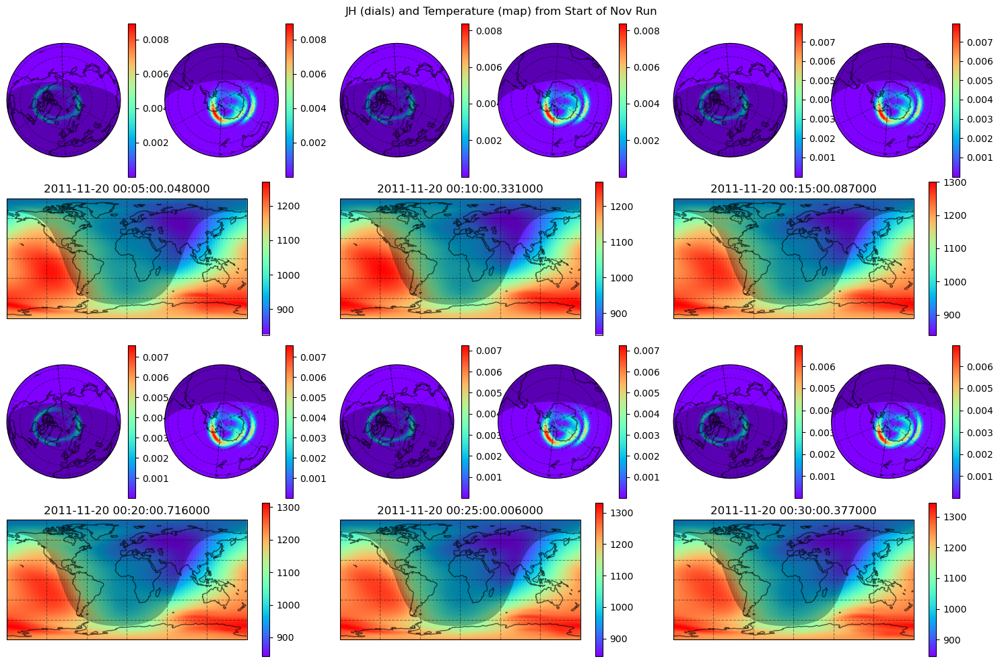

In [544]:
map_and_dials(dial_da=nov_half.AltIntJouleHeating_W_m2,
              total=6,
              map_da=nov_half.Temperature.sel(alt=450, method='nearest'),
              max_per_row=3,
              time_start='2011-11-20 00:05:00',
              time_delta='5 minutes',
              suptitle='JH (dials) and Temperature (map) from Start of Nov Run')